# Tensorflow 2 Object Detection: Train model With Cat Dataset



# ObjectDetection_Cat
Object detection using Tensorflow Object Detection API.

## References

This project is based in the [tutorial](https://gilberttanner.com/blog/object-detection-with-tensorflow-2/) provided by Gilbert Tanner.

The notebook was run using google colab in a custom Dataset created by myself.

## Dataset

The dataset is comprised of 107 images and 107 annotations. Part of the images was aquired via google images and the remaining are personal images of my pet cat or pictures I had saved from other cats. All the annotations were provided by me, using label-studio. In this repository, it will be archive.zip, which contains the image files, the annotations and two .csv files containing the labels in a format readable by tensorflow API.

## Model

The model used was EfficientDet D0 512x512, that was used in the tutorial. The model was already pretrained on the [COCO](https://cocodataset.org/#home) dataset and it is then downloaded and trained again on my own dataset. The link to the [model paper](https://openaccess.thecvf.com/content_CVPR_2020/papers/Tan_EfficientDet_Scalable_and_Efficient_Object_Detection_CVPR_2020_paper.pdf).

[Code for the model](https://github.com/google/automl/tree/master/efficientdet).

The file will also be provided here.

All the files will also be available in [github](https://github.com/raphaelgri/ObjectDetection_Cat)

## File Types

I was not able to convert all the files to .h5 format, due to the saved_model and dataset being of non uniform format (images had different sizes and the model was generated by another script)

### How to run the notebook

The notebook already contains all the commands for running it on Google Colab, including training. The training part can be skipped as the saved model will be downloaded from the GitHub repository.

## Installation

Installing the Tensorflow Object Detection API became a lot easier with the relase of Tensorflow 2. The following few cells are all that is needed in order to install the OD API.

In [ ]:
!pip install tensorflow=="2.6.0"

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 458.4/458.4 MB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.0/132.0 KB 20.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.9/14.9 MB 82.3 MB/s eta 0:00:00
  Created wheel for clang: filename=clang-5.0-py3-none-any.whl size=30694 sha256=e37fa4b9e343e9e46da08aadb2b7c598e51465ae2ecb3e0dc564f174921a069c
  Stored in directory: /root/.cache/pip/wheels/f1/60/77/22b9b5887bd47801796a856f47650d9789c74dc3161a26d608
  Created wheel for termcolor: filename=termcolor-1.1.0-py3-none-any.whl size=4849 sha256=c2e83d0a71686d89fa173a5690b6a01cd87e9f1c7cd397f35ba2774d60627631
  Stored in directory: /root/.cache/pip/wheels/a0/16/9c/5473df82468f958445479c59e784896fa24f4a5fc024b0f501
  Created wheel for 

In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3638, done.
remote: Counting objects: 100% (3638/3638), done.
remote: Compressing objects: 100% (3035/3035), done.
remote: Total 3638 (delta 961), reused 1569 (delta 549), pack-reused 0
Receiving objects: 100% (3638/3638), 47.37 MiB | 2.08 MiB/s, done.
Resolving deltas: 100% (961/961), done.


In [ ]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.5/14.5 MB 55.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.1/352.1 KB 41.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 88.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 63.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 KB 16.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 41.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 238.9/238.9 KB 27.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━

In [ ]:
#run model builder test
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

2023-01-08 15:27:53.498141: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-08 15:27:54.529609: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-08 15:27:54.529886: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-08 15:27:54.529923: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF

## Prepare data


In [ ]:
#gets dataset from my github repository
!wget https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/archive.zip

--2023-01-08 15:28:46--  https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/archive.zip
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/archive.zip [following]
--2023-01-08 15:28:46--  https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/archive.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8948061 (8.5M) [application/zip]
Saving to: ‘archive.zip’

archive.zip         100%[===================>]   8.53M  --.-KB/s    in 0.07s   

2023-01-08 15:28:47 (120 MB/s) - ‘archive.zip’ saved [8948061/8948061]



In [ ]:
#unzip files
!unzip archive.zip

Archive:  archive.zip
   creating: cat-data/
   creating: cat-data/test/
  inflating: cat-data/test/d0678e20-330px-Ragdoll_from_Gatil_Ragbelas.jpg  
  inflating: cat-data/test/d0678e20-330px-Ragdoll_from_Gatil_Ragbelas.xml  
  inflating: cat-data/test/d43bc77b-PXL_20210528_140152818.jpg  
  inflating: cat-data/test/d43bc77b-PXL_20210528_140152818.xml  
  inflating: cat-data/test/d57602a3-pet-7308330__340.jpg  
  inflating: cat-data/test/d57602a3-pet-7308330__340.xml  
  inflating: cat-data/test/d9df21fb-cat-2934720__340.jpg  
  inflating: cat-data/test/d9df21fb-cat-2934720__340.xml  
  inflating: cat-data/test/df74ce67-kitten-3442257__340.jpg  
  inflating: cat-data/test/df74ce67-kitten-3442257__340.xml  
  inflating: cat-data/test/df9a1632-russian-blue-cat-5774414__340.jpg  
  inflating: cat-data/test/df9a1632-russian-blue-cat-5774414__340.xml  
  inflating: cat-data/test/e2aaf070-PXL_20210308_153419924.MP.jpg  
  inflating: cat-data/test/e2aaf070-PXL_20210308_153419924.MP.xml  
  inf

In [ ]:
#gets generate_trf file from my github repository
!wget https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/generate_tfrecord.py

--2023-01-08 15:28:47--  https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/generate_tfrecord.py
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/generate_tfrecord.py [following]
--2023-01-08 15:28:47--  https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/generate_tfrecord.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3294 (3.2K) [text/plain]
Saving to: ‘generate_tfrecord.py’

generate_tfrecord.p 100%[===================>]   3.22K  --.-KB/s    in 0s      

2023-01-08 15:28:47 (44.6 MB/s) - ‘generate_tfrecord.py’ saved [3294/3294]


In [ ]:
#gets labelmap file from my github repository
!wget https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/labelmap.pbtxt

--2023-01-08 15:28:47--  https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/labelmap.pbtxt
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/labelmap.pbtxt [following]
--2023-01-08 15:28:48--  https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/labelmap.pbtxt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35 [text/plain]
Saving to: ‘labelmap.pbtxt’

labelmap.pbtxt      100%[===================>]      35  --.-KB/s    in 0s      

2023-01-08 15:28:48 (967 KB/s) - ‘labelmap.pbtxt’ saved [35/35]



In [ ]:
!python generate_tfrecord.py --csv_input=cat-data/train_labels.csv --image_dir=cat-data/train --output_path=train.record
!python generate_tfrecord.py --csv_input=cat-data/test_labels.csv --image_dir=cat-data/test --output_path=test.record

2023-01-08 15:28:48.859265: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-08 15:28:50.273714: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-08 15:28:50.273828: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-08 15:28:50.273848: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF

In [ ]:
train_record_path = '/content/train.record'
test_record_path = '/content/test.record'
labelmap_path = '/content/labelmap.pbtxt'

## Configuring training

Now that the data is ready it's time to create a training configuration. The OD API supports lots of models, each with its own config file. In this notebook I'm making use of EfficientDet, but you can replace it with any model available in the [Tensorflow 2 Detection Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md).

In [ ]:
batch_size = 16
num_steps = 8000
num_eval_steps = 1000

In [ ]:
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
!tar -xf efficientdet_d0_coco17_tpu-32.tar.gz

--2023-01-08 15:28:59--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d0_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.145.128, 2a00:1450:4013:c14::80
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.145.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30736482 (29M) [application/x-tar]
Saving to: ‘efficientdet_d0_coco17_tpu-32.tar.gz’

efficientdet_d0_coc 100%[===================>]  29.31M  83.6MB/s    in 0.4s    

2023-01-08 15:29:00 (83.6 MB/s) - ‘efficientdet_d0_coco17_tpu-32.tar.gz’ saved [30736482/30736482]



In [ ]:
fine_tune_checkpoint = 'efficientdet_d0_coco17_tpu-32/checkpoint/ckpt-0'

In [ ]:
!wget https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config

base_config_path = 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config'

--2023-01-08 15:29:01--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_efficientdet_d0_512x512_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4630 (4.5K) [text/plain]
Saving to: ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’

ssd_efficientdet_d0 100%[===================>]   4.52K  --.-KB/s    in 0s      

2023-01-08 15:29:01 (47.7 MB/s) - ‘ssd_efficientdet_d0_512x512_coco17_tpu-8.config’ saved [4630/4630]



In [ ]:
# edit configuration file (from https://colab.research.google.com/drive/1sLqFKVV94wm-lglFq_0kGo2ciM0kecWD)

import re

with open(base_config_path) as f:
    config = f.read()

with open('model_config.config', 'w') as f:
  
  # Set labelmap path
  config = re.sub('label_map_path: ".*?"', 
             'label_map_path: "{}"'.format(labelmap_path), config)
  
  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                  'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), config)
  
  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 
                  'input_path: "{}"'.format(train_record_path), config)
  
  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 
                  'input_path: "{}"'.format(test_record_path), config)
  
  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  'num_classes: {}'.format(1), config) #just one class, 'Cat'
  
  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  'batch_size: {}'.format(batch_size), config)
  
  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  'num_steps: {}'.format(num_steps), config)
  
  # Set fine-tune checkpoint type to detection
  config = re.sub('fine_tune_checkpoint_type: "classification"', 
             'fine_tune_checkpoint_type: "{}"'.format('detection'), config)
  
  f.write(config)

In [ ]:
%cat model_config.config

 # SSD with EfficientNet-b0 + BiFPN feature extractor,
# shared box predictor and focal loss (a.k.a EfficientDet-d0).
# See EfficientDet, Tan et al, https://arxiv.org/abs/1911.09070
# See Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from an EfficientNet-b0 checkpoint.
#
# Train on TPU-8

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 1
    add_background_class: false
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      m

In [ ]:
model_dir = 'training/'
pipeline_config_path = 'model_config.config'

## Train detector

# Can be skipped if downloading the saved model from github !!!

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2023-01-08 14:16:49.360101: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-08 14:16:49.511688: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-01-08 14:16:50.387697: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-08 14:16:50.387815: W tensorflow/compiler/xla/stream_executor

In [ ]:
# SKIP IF NOT TRAINED
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Export model inference graph

In [ ]:
output_directory = 'inference_graph'

In [ ]:
# SKIP IF NOT TRAINED !!!

!python /content/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_config_path}

2023-01-08 15:00:04.702111: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-08 15:00:04.857979: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-01-08 15:00:05.737878: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-08 15:00:05.737984: W tensorflow/compiler/xla/stream_executor

In [ ]:
#SKIP IF NOT TRAINED
#FOR SAVING THE MODEL
!zip -r inference_graph.zip inference_graph

  adding: inference_graph/ (stored 0%)
  adding: inference_graph/checkpoint/ (stored 0%)
  adding: inference_graph/checkpoint/ckpt-0.index (deflated 80%)
  adding: inference_graph/checkpoint/checkpoint (deflated 41%)
  adding: inference_graph/checkpoint/ckpt-0.data-00000-of-00001 (deflated 36%)
  adding: inference_graph/saved_model/ (stored 0%)
  adding: inference_graph/saved_model/assets/ (stored 0%)
  adding: inference_graph/saved_model/saved_model.pb (deflated 93%)
  adding: inference_graph/saved_model/variables/ (stored 0%)
  adding: inference_graph/saved_model/variables/variables.index (deflated 78%)
  adding: inference_graph/saved_model/variables/variables.data-00000-of-00001 (deflated 36%)
  adding: inference_graph/saved_model/fingerprint.pb (stored 0%)
  adding: inference_graph/pipeline.config (deflated 68%)


In [ ]:
#SKIP IF NOT TRAINED
from google.colab import files
files.download(f'/content/{output_directory}/saved_model/saved_model.pb') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#RUN IF NOT TRAINED
#download model from github
!wget https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/inference_graph.zip
!unzip inference_graph.zip

--2023-01-08 15:29:03--  https://github.com/raphaelgri/ObjectDetection_Cat/raw/main/inference_graph.zip
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/inference_graph.zip [following]
--2023-01-08 15:29:03--  https://raw.githubusercontent.com/raphaelgri/ObjectDetection_Cat/main/inference_graph.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30216561 (29M) [application/zip]
Saving to: ‘inference_graph.zip’

inference_graph.zip 100%[===================>]  28.82M   142MB/s    in 0.2s    

2023-01-08 15:29:05 (142 MB/s) - ‘inference_graph.zip’ saved [30216561/

## Test trained model on test images


In [ ]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path (this can be local or on colossus)

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)

In [ ]:
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'/content/{output_directory}/saved_model') #for trained model

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

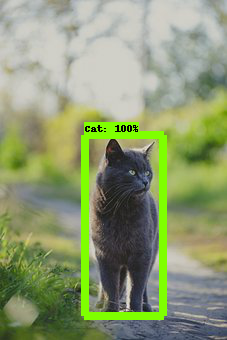

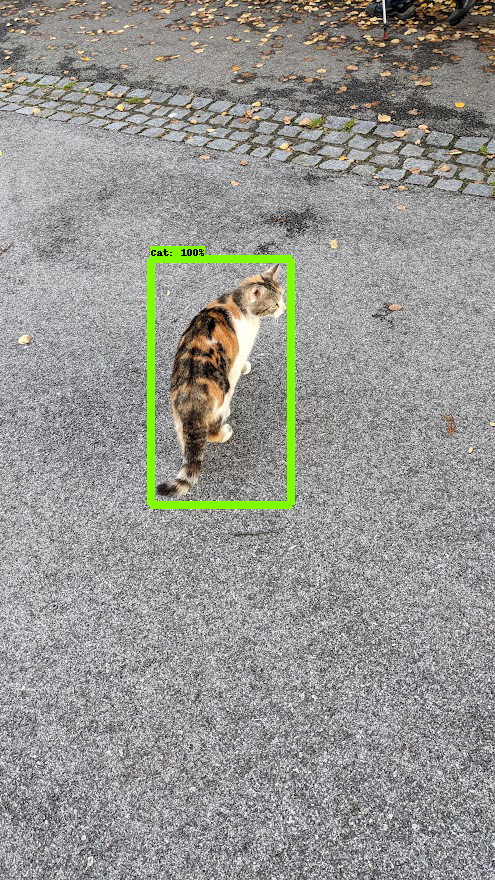

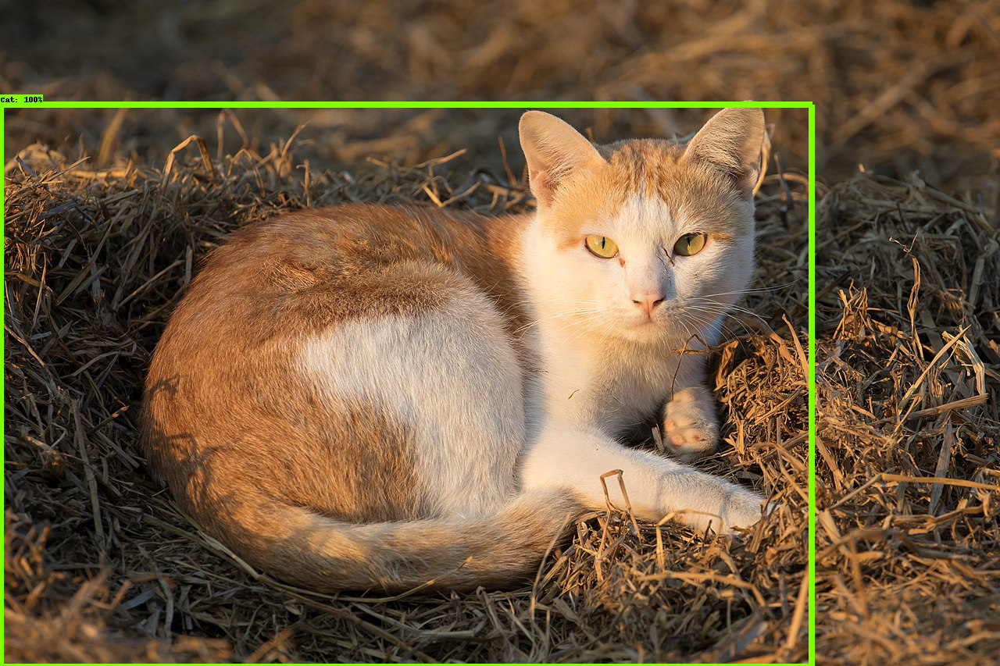

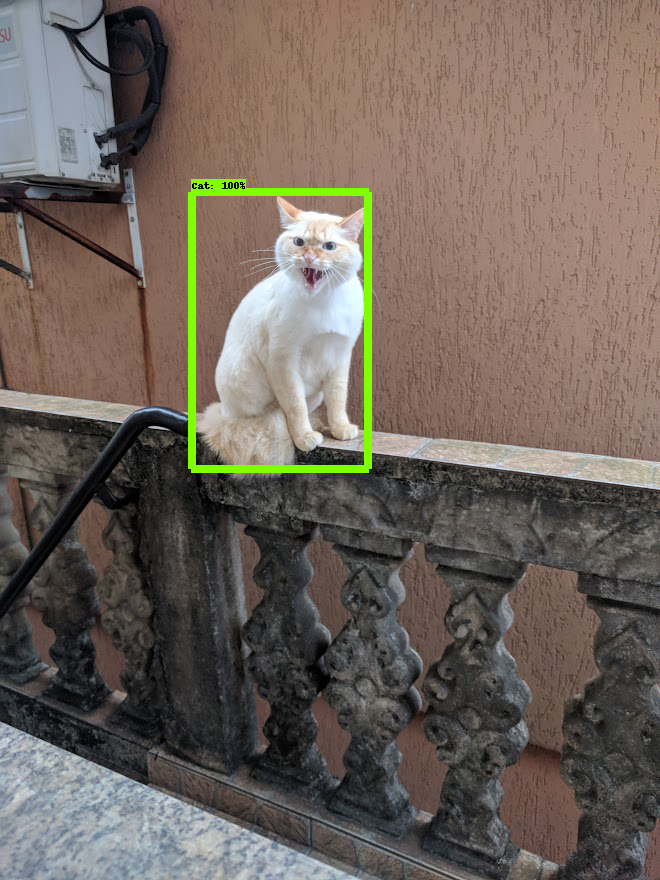

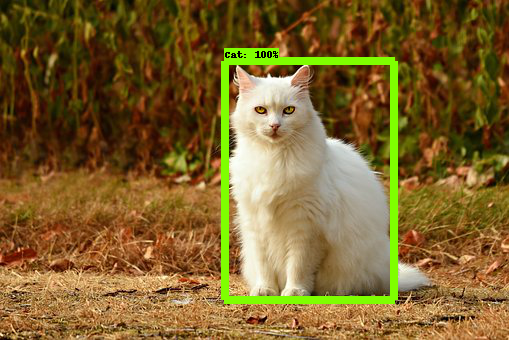

...

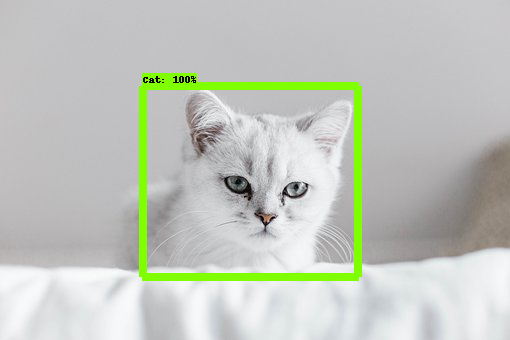

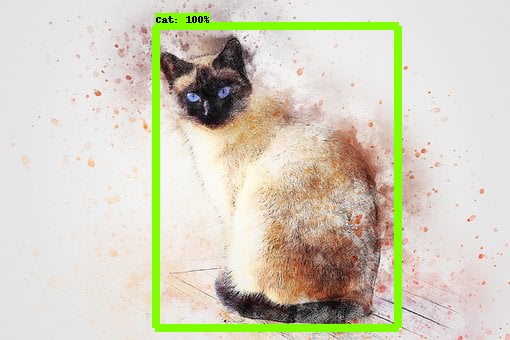

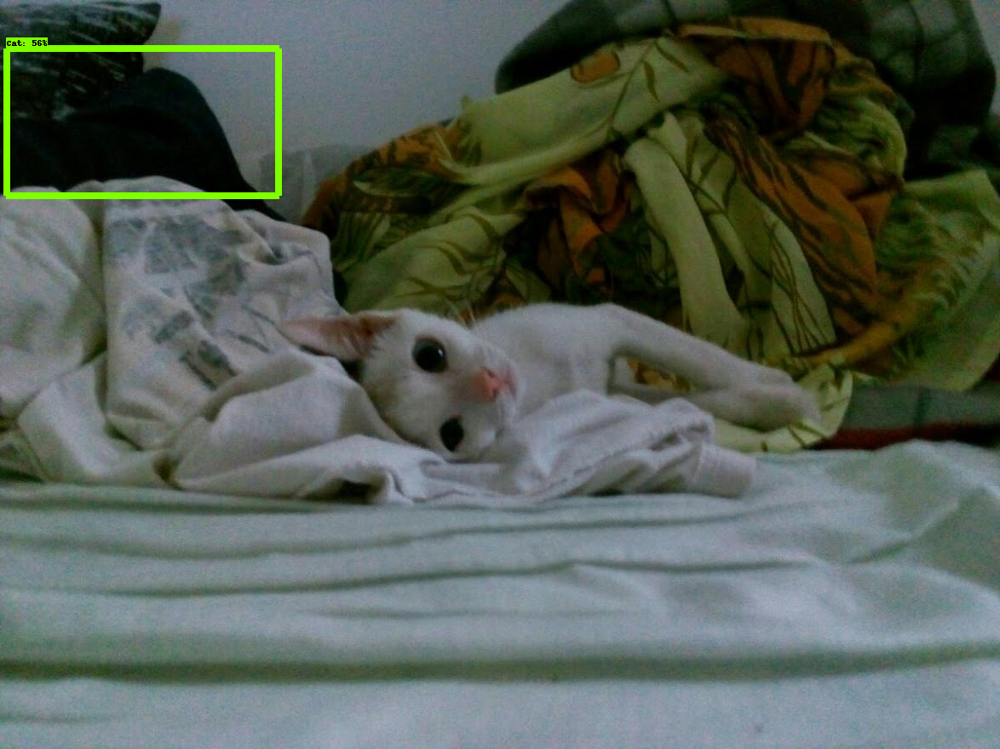

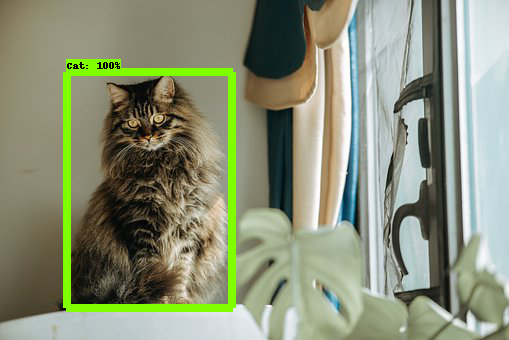

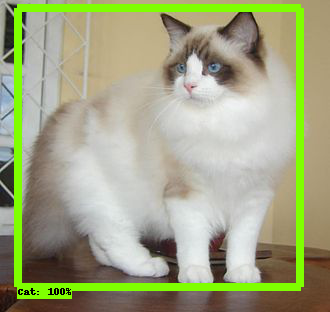

In [ ]:
for image_path in glob.glob('cat-data/test/*.jpg'):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))